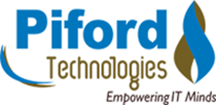

In [23]:
# pip install --upgrade pip

In [146]:
#!python -m pip install --upgrade pip

#!pip install tensorflow==2.3.1 

#!pip install tensorboard==2.4.1
!pip install torch  
#YOLOv5 runs on top of PyTorch, so we need to import it to the notebook

  Using cached torch-1.11.0-cp310-cp310-win_amd64.whl (158.0 MB)


In [147]:
!python -m pip install --upgrade pip

In [85]:
import torch # YOLOv5 implemented using pytorch

In [189]:
from IPython.display import Image #this is to render predictions

In [150]:
# !git clone https://github.com/ultralytics/yolov5

In [87]:
%cd YoloV5

E:\code\Vehicle_Count\Traffic_Signs_Dataset\YoloV5


In [152]:
!pip install -r requirements.txt

# Divide the dataset in train and val folder. 

In [154]:
import os
from random import choice
import shutil

#arrays to store file names
imgs =[]
xmls =[]

#setup dir names
trainPath = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/data/images/train'
valPath = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/data/images/val'
crsPath = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/dataset' #dir where images and annotations stored

#setup ratio (val ratio = rest of the files in origin dir after splitting into train and test)
train_ratio = 0.8
val_ratio = 0.2


#total count of imgs
totalImgCount = len(os.listdir(crsPath))/2

#soring files to corresponding arrays
for (dirname, dirs, files) in os.walk(crsPath):
    for filename in files:
        if filename.endswith('.txt'):
            xmls.append(filename)
        else:
            imgs.append(filename)


#counting range for cycles
countForTrain = int(len(imgs)*train_ratio)
countForVal = int(len(imgs)*val_ratio)
print("training images are : ",countForTrain)
print("Validation images are : ",countForVal)


training images are :  80
Validation images are :  20


In [84]:

trainimagePath = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/data/images/train'
trainlabelPath = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/data/labels/train'
valimagePath = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/data/images/val'
vallabelPath = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/data/labels/val'
#cycle for train dir
for x in range(countForTrain):

    fileJpg = choice(imgs) # get name of random image from origin dir
    fileXml = fileJpg[:-4] +'.txt' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(trainlabelPath, fileXml))
    shutil.copy(os.path.join(crsPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath, fileXml), os.path.join(trainlabelPath, fileXml))


    #remove files from arrays
    imgs.remove(fileJpg)
    xmls.remove(fileXml)



#cycle for test dir   
for x in range(countForVal):

    fileJpg = choice(imgs) # get name of random image from origin dir
    fileXml = fileJpg[:-4] +'.txt' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(valimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(vallabelPath, fileXml))
    shutil.copy(os.path.join(crsPath, fileJpg), os.path.join(valimagePath, fileJpg))
    shutil.copy(os.path.join(crsPath, fileXml), os.path.join(vallabelPath, fileXml))
    
    #remove files from arrays
    imgs.remove(fileJpg)
    xmls.remove(fileXml)

#rest of files will be validation files, so rename origin dir to val dir
#os.rename(crsPath, valPath)
shutil.move(crsPath, valPath) 

NameError: name 'countForTrain' is not defined

# Create dataset.yaml

### move the dataset’s dataset.yaml file to the /content/yolov5/data directory. 
### This file contains information required by YOLO to train the model on the custom data. 

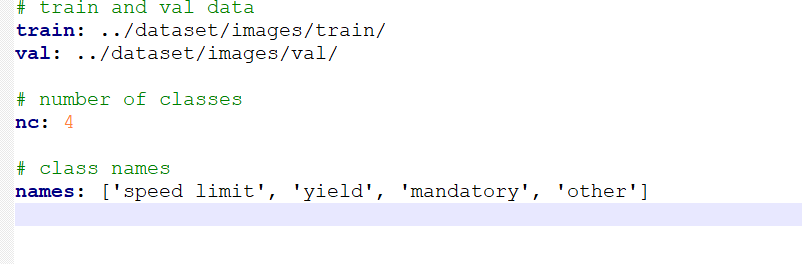

## At the end of the training, two files should be saved in yolov5/runs/train/exp/weights: last.pt and best.pt. We’ll use best.pt.

## Explore the metrics recorded during training, I suggest you use TensorBoard, a very interactive exploration tool:

In [275]:
!python train.py --img 80 --batch 32 --epochs 3 --data dataset.yaml --weights yolov5x.pt --cache

Starting...


train: weights=yolov5x.pt, cfg=, data=dataset.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=200, batch_size=32, imgsz=80, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs\train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 
YOLOv5  v6.1-253-g75bbaa8 Python-3.10.4 torch-1.11.0+cpu CPU

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.

  0%|          | 0/3 [00:00<?, ?it/s]
     2/199        0G    0.2093 0.0008379   0.03765        88        96:   0%|          | 0/3 [00:05<?, ?it/s]
     2/199        0G    0.2093 0.0008379   0.03765        88        96:  33%|###3      | 1/3 [00:05<00:11,  5.61s/it]
     2/199        0G    0.2095 0.0008748   0.03784       109        96:  33%|###3      | 1/3 [00:11<00:11,  5.61s/it]
     2/199        0G    0.2095 0.0008748   0.03784       109        96:  67%|######6   | 2/3 [00:11<00:05,  5.68s/it]
     2/199        0G    0.2092 0.0008392   0.03765        46        96:  67%|######6   | 2/3 [00:14<00:05,  5.68s/it]
     2/199        0G    0.2092 0.0008392   0.03765        46        96: 100%|##########| 3/3 [00:14<00:00,  4.68s/it]
     2/199        0G    0.2092 0.0008392   0.03765        46        96: 100%|##########| 3/3 [00:14<00:00,  4.94s/it]

               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95:   0%|          | 0/2 [00:00<?, ?it/s]
               Cl

               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100%|##########| 2/2 [00:07<00:00,  3.59s/it]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100%|##########| 2/2 [00:07<00:00,  3.62s/it]
                 all        121          0          0          0          0          0

     Epoch   gpu_mem       box       obj       cls    labels  img_size

  0%|          | 0/3 [00:00<?, ?it/s]
    12/199        0G    0.1715  0.001856   0.03403        81        96:   0%|          | 0/3 [00:05<?, ?it/s]
    12/199        0G    0.1715  0.001856   0.03403        81        96:  33%|###3      | 1/3 [00:05<00:11,  5.77s/it]
    12/199        0G    0.1703  0.002228    0.0342        95        96:  33%|###3      | 1/3 [00:11<00:11,  5.77s/it]
    12/199        0G    0.1703  0.002228    0.0342        95        96:  67%|######6   | 2/3 [00:11<00:05,  5.83s/it]
    12/199        0G    0.1698  0.002158   0.03319        38        96

     Epoch   gpu_mem       box       obj       cls    labels  img_size

  0%|          | 0/3 [00:00<?, ?it/s]
    48/199        0G    0.1442  0.004177   0.02914        81        96:   0%|          | 0/3 [00:05<?, ?it/s]
    48/199        0G    0.1442  0.004177   0.02914        81        96:  33%|###3      | 1/3 [00:05<00:11,  5.56s/it]
    48/199        0G     0.145  0.004083   0.02813        94        96:  33%|###3      | 1/3 [00:11<00:11,  5.56s/it]
    48/199        0G     0.145  0.004083   0.02813        94        96:  67%|######6   | 2/3 [00:11<00:05,  6.00s/it]
    48/199        0G     0.147  0.003938   0.02769        46        96:  67%|######6   | 2/3 [00:14<00:05,  6.00s/it]
    48/199        0G     0.147  0.003938   0.02769        46        96: 100%|##########| 3/3 [00:14<00:00,  4.62s/it]
    48/199        0G     0.147  0.003938   0.02769        46        96: 100%|##########| 3/3 [00:14<00:00,  4.95s/it]

               Class     Images     Labels          P          R     mA

                 all        121        108      0.373     0.0907     0.0213    0.00645

     Epoch   gpu_mem       box       obj       cls    labels  img_size

  0%|          | 0/3 [00:00<?, ?it/s]
   100/199        0G    0.1233  0.007453   0.02269        88        96:   0%|          | 0/3 [00:05<?, ?it/s]
   100/199        0G    0.1233  0.007453   0.02269        88        96:  33%|###3      | 1/3 [00:05<00:11,  5.68s/it]
   100/199        0G    0.1263  0.006948   0.02318        90        96:  33%|###3      | 1/3 [00:12<00:11,  5.68s/it]
   100/199        0G    0.1263  0.006948   0.02318        90        96:  67%|######6   | 2/3 [00:12<00:06,  6.64s/it]
   100/199        0G    0.1276  0.006862   0.02375        52        96:  67%|######6   | 2/3 [00:16<00:06,  6.64s/it]
   100/199        0G    0.1276  0.006862   0.02375        52        96: 100%|##########| 3/3 [00:16<00:00,  5.13s/it]
   100/199        0G    0.1276  0.006862   0.02375        52        96: 100%|##########| 3/3 [00:16<00

     Epoch   gpu_mem       box       obj       cls    labels  img_size

  0%|          | 0/3 [00:00<?, ?it/s]
   106/199        0G    0.1292  0.006288   0.01997        88        96:   0%|          | 0/3 [00:06<?, ?it/s]
   106/199        0G    0.1292  0.006288   0.01997        88        96:  33%|###3      | 1/3 [00:06<00:12,  6.02s/it]
   106/199        0G    0.1296   0.00633   0.02201        95        96:  33%|###3      | 1/3 [00:13<00:12,  6.02s/it]
   106/199        0G    0.1296   0.00633   0.02201        95        96:  67%|######6   | 2/3 [00:13<00:06,  6.63s/it]
   106/199        0G    0.1314  0.006108    0.0227        44        96:  67%|######6   | 2/3 [00:16<00:06,  6.63s/it]
   106/199        0G    0.1314  0.006108    0.0227        44        96: 100%|##########| 3/3 [00:16<00:00,  5.13s/it]
   106/199        0G    0.1314  0.006108    0.0227        44        96: 100%|##########| 3/3 [00:16<00:00,  5.48s/it]

               Class     Images     Labels          P          R     mA

               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100%|##########| 2/2 [00:11<00:00,  5.89s/it]
                 all        121        108     0.0965      0.138     0.0291     0.0105

     Epoch   gpu_mem       box       obj       cls    labels  img_size

  0%|          | 0/3 [00:00<?, ?it/s]
   193/199        0G    0.1104   0.00612   0.02053        73        96:   0%|          | 0/3 [00:05<?, ?it/s]
   193/199        0G    0.1104   0.00612   0.02053        73        96:  33%|###3      | 1/3 [00:05<00:11,  5.88s/it]
   193/199        0G    0.1131  0.006326   0.02089        89        96:  33%|###3      | 1/3 [00:11<00:11,  5.88s/it]
   193/199        0G    0.1131  0.006326   0.02089        89        96:  67%|######6   | 2/3 [00:11<00:05,  5.46s/it]
   193/199        0G    0.1142  0.006624    0.0202        48        96:  67%|######6   | 2/3 [00:14<00:05,  5.46s/it]
   193/199        0G    0.1142  0.006624    0.0202        48        96: 100%|#########

train: weights=yolov5x.pt, cfg=, data=dataset.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=3, batch_size=32, imgsz=80, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs\train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
YOLOv5  v6.1-253-g75bbaa8 Python-3.10.4 torch-1.11.0+cpu CPU

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.5, shear=0.0, perspective=0.0, flipud=0.0, fliplr=0.5, mosaic=1.0

Starting...
Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds


 19          [-1, 14]  1         0  models.common.Concat                    [1]                           
 20                -1  4   4922880  models.common.C3                        [640, 640, 4, False]          
 21                -1  1   3687680  models.common.Conv                      [640, 640, 3, 2]              
 22          [-1, 10]  1         0  models.common.Concat                    [1]                           
 23                -1  4  19676160  models.common.C3                        [1280, 1280, 4, False]        
 24      [17, 20, 23]  1     53832  models.yolo.Detect                      [3, [[10, 13, 16, 30, 33, 23], [30, 61, 62, 45, 59, 119], [116, 90, 156, 198, 373, 326]], [320, 640, 1280]]
Model summary: 567 layers, 86231272 parameters, 86231272 gradients

Transferred 739/745 items from yolov5x.pt
Scaled weight_decay = 0.0005
optimizer: SGD with parameter groups 123 weight (no decay), 126 weight, 126 bias

train: Scanning 'E:\code\Vehicle_Count\Traffic_Signs_Dataset

AttributeError: 'NoneType' object has no attribute '_free_weak_ref'
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\multiprocessing\reductions.py", line 36, in __del__
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\multiprocessing\reductions.py", line 36, in __del__
Exception ignored in: <function StorageWeakRef.__del__ at 0x000001D589325240>
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\storage.py", line 520, in _free_weak_ref
Traceback (most recent call last):
Exception ignored in: <function StorageWeakRef.__del__ at 0x0000021834A05240>
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\storage.py", line 520, in _free_weak_ref
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\multiprocessing\reductions.py", line 36, in __del__
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-pa

Exception ignored in: <function StorageWeakRef.__del__ at 0x000001D092845240>
Traceback (most recent call last):
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\multiprocessing\reductions.py", line 36, in __del__
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\storage.py", line 520, in _free_weak_ref
AttributeError: 'NoneType' object has no attribute '_free_weak_ref'
Exception ignored in: <function StorageWeakRef.__del__ at 0x000001D092845240>
Traceback (most recent call last):
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\multiprocessing\reductions.py", line 36, in __del__
  File "C:\Users\user\AppData\Local\Programs\Python\Python310\lib\site-packages\torch\storage.py", line 520, in _free_weak_ref
AttributeError: 'NoneType' object has no attribute '_free_weak_ref'
Exception ignored in: <function StorageWeakRef.__del__ at 0x000001D092845240>
Traceback (most recent call la

In [200]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 5476), started 16:46:58 ago. (Use '!kill 5476' to kill it.)

Training losses and performance metrics are also logged to Tensorboard and a custom results.txt logfile which is plotted as results.png (below) after training completes. 

You’ll be implementing the detect.py script with the best.pt weights and image dimensions of 416x416 pixels (it’s really important to comply with that). The results will be saved to runs/detect/exp. To display the results, run the following code:

In [277]:
#!python detect.py --source runs/train/exp/testimg.jpg --weights runs/train/exp/weights/best.pt --conf 0.25
!python detect.py --source runs/train/000004.jpg --conf 0.25 --save-txt --save-conf
# !python detect.py --source runs/train/000000.jpg --conf 0.40 --save-txt --save-conf --weights runs/train/exp14/weights/best.pt

detect: weights=yolov5s.pt, source=runs/train/000004.jpg, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5  v6.1-253-g75bbaa8 Python-3.10.4 torch-1.11.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
image 1/1 E:\code\Vehicle_Count\Traffic_Signs_Dataset\YoloV5\runs\train\000004.jpg: 384x640 4 cars, 2 trains, 1 truck, Done. (0.185s)
Speed: 0.0ms pre-process, 184.5ms inference, 1.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs\detect\exp24
1 labels saved to runs\detect\exp24\labels


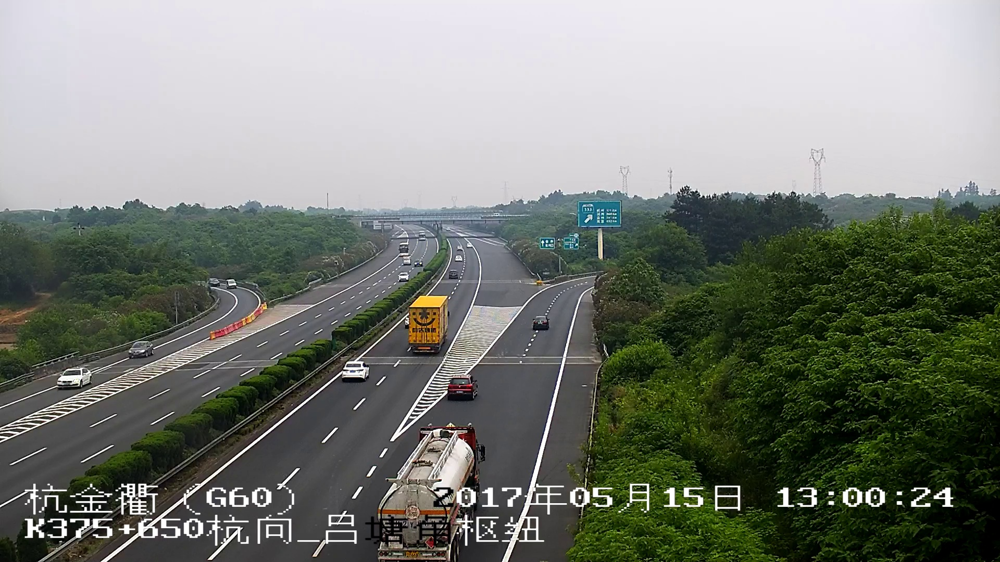

In [92]:
# Image
Image(filename='runs/train/000004.jpg', width=500)

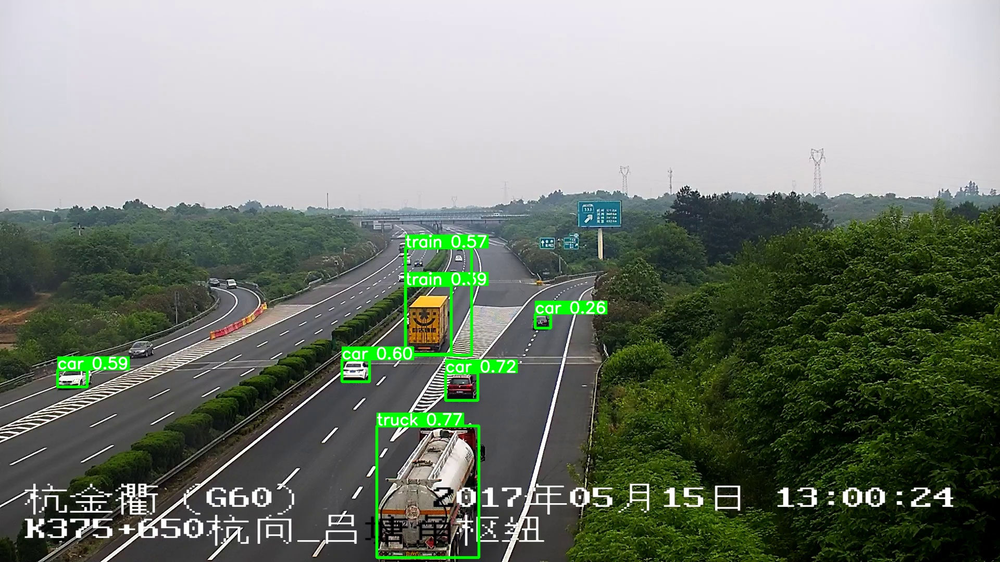

In [91]:
# Predicted Image
Image(filename='runs/detect/exp23/000004.jpg', width=500)

In [93]:
#Print vehicle count
file1 = open('E:/code/Vehicle_Count/Traffic_Signs_Dataset/YoloV5/runs/detect/exp20/labels/000004.txt', 'r')
Lines = file1.readlines()
  
total_count = 0
car_count = 0
bus_count = 0
truck_count = 0
# Strips the newline character
for line in Lines:
    if(line.strip().split()[0]=="0"):
        car_count+=1
    elif(line.strip().split()[0]=="1"):
        bus_count+=1
    elif(line.strip().split()[0]=="2"):
        truck_count+=1
total_count1=car_count+bus_count+truck_count

total_count2=len(Lines)

print("______________________\n")
print("  Total Vehicles: {}".format(total_count2))
print("______________________")

______________________

  Total Vehicles: 7
______________________


In [ ]:
# !python val.py --data dataset.yaml --weights runs/train/exp20/weights/best.pt 

In [281]:
# ________________________________________________________________________

In [79]:
import cv2
import numpy as np

In [80]:
# read image
img = cv2.imread("E:/code/Vehicle_Count/Traffic_Signs_Dataset/000000.jpg")
print(img)

[[[228 208 183]
  [228 208 183]
  [228 208 183]
  ...
  [252 250 250]
  [250 249 251]
  [253 252 255]]

 [[228 208 183]
  [228 208 183]
  [228 208 183]
  ...
  [255 255 255]
  [255 254 255]
  [252 251 255]]

 [[228 208 183]
  [228 208 183]
  [228 208 183]
  ...
  [255 255 255]
  [255 253 255]
  [255 254 255]]

 ...

 [[ 34  89  72]
  [ 66 124 106]
  [ 59 117  99]
  ...
  [ 32  45  37]
  [ 30  43  35]
  [ 22  35  27]]

 [[ 27  84  69]
  [ 50 107  92]
  [ 52 109  94]
  ...
  [ 30  40  34]
  [ 25  35  29]
  [ 16  26  20]]

 [[ 28  85  70]
  [ 64 121 106]
  [ 46 105  90]
  ...
  [ 29  39  33]
  [ 26  36  30]
  [ 22  32  26]]]


In [81]:

#== Parameters =======================================================================
BLUR = 21
CANNY_THRESH_1 = 12
CANNY_THRESH_2 = 200
MASK_DILATE_ITER = 10
MASK_ERODE_ITER = 10
MASK_COLOR = (0.0,0.0,1.0) # In BGR format


#== Processing =======================================================================

#-- Read image -----------------------------------------------------------------------
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

#-- Edge detection -------------------------------------------------------------------
edges = cv2.Canny(gray, CANNY_THRESH_1, CANNY_THRESH_2)
edges = cv2.dilate(edges, None)
edges = cv2.erode(edges, None)

#-- Find contours in edges, sort by area ---------------------------------------------
contour_info = []
contours, _ = cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
print(cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE))

((array([[[1737, 1076]],

       [[1738, 1075]],

       [[1739, 1075]],

       [[1740, 1075]],

       [[1741, 1076]],

       [[1741, 1077]],

       [[1741, 1078]],

       [[1740, 1079]],

       [[1739, 1079]],

       [[1738, 1079]],

       [[1737, 1078]],

       [[1737, 1077]]], dtype=int32), array([[[ 483, 1076]],

       [[ 484, 1075]],

       [[ 485, 1075]],

       [[ 486, 1075]],

       [[ 487, 1076]],

       [[ 487, 1077]],

       [[ 487, 1078]],

       [[ 486, 1079]],

       [[ 485, 1079]],

       [[ 484, 1079]],

       [[ 483, 1078]],

       [[ 483, 1077]]], dtype=int32), array([[[ 424, 1075]],

       [[ 425, 1074]],

       [[ 426, 1074]],

       [[ 427, 1074]],

       [[ 428, 1075]],

       [[ 428, 1076]],

       [[ 428, 1077]],

       [[ 427, 1078]],

       [[ 426, 1078]],

       [[ 425, 1078]],

       [[ 424, 1077]],

       [[ 424, 1076]]], dtype=int32), array([[[ 193, 1075]],

       [[ 194, 1074]],

       [[ 195, 1074]],

       [[ 196, 1074]

In [82]:
# Previously, for a previous version of cv2, this line was: 
#  contours, _ = cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
# Thanks to notes from commenters, I've updated the code but left this note
for c in contours:
    contour_info.append((
        c,
        cv2.isContourConvex(c),
        cv2.contourArea(c),
    ))
contour_info = sorted(contour_info, key=lambda c: c[2], reverse=True)
max_contour = contour_info[0]

#-- Create empty mask, draw filled polygon on it corresponding to largest contour ----
# Mask is black, polygon is white
mask = np.zeros(edges.shape)
cv2.fillConvexPoly(mask, max_contour[0], (255))

#-- Smooth mask, then blur it --------------------------------------------------------
mask = cv2.dilate(mask, None, iterations=MASK_DILATE_ITER)
mask = cv2.erode(mask, None, iterations=MASK_ERODE_ITER)
mask = cv2.GaussianBlur(mask, (BLUR, BLUR), 0)
mask_stack = np.dstack([mask]*3)    # Create 3-channel alpha mask

#-- Blend masked img into MASK_COLOR background --------------------------------------
mask_stack  = mask_stack.astype('float32') / 255.0          # Use float matrices, 
img         = img.astype('float32') / 255.0                 #  for easy blending

masked = (mask_stack * img) + ((1-mask_stack) * MASK_COLOR) # Blend
masked = (masked * 255).astype('uint8')                     # Convert back to 8-bit 

# cv2.imshow('img', masked)                                   # Display
# cv2.waitKey()

cv2.imwrite('E:/code/Vehicle_Count/Traffic_Signs_Dataset/00000x.jpg', masked)           # Save

True

In [97]:
from skimage import io as skio
url = 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/000000.jpg'
img = skio.imread(url)

In [98]:
from skimage import filters
sobel = filters.sobel(img)

In [99]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['figure.dpi'] = 200

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  


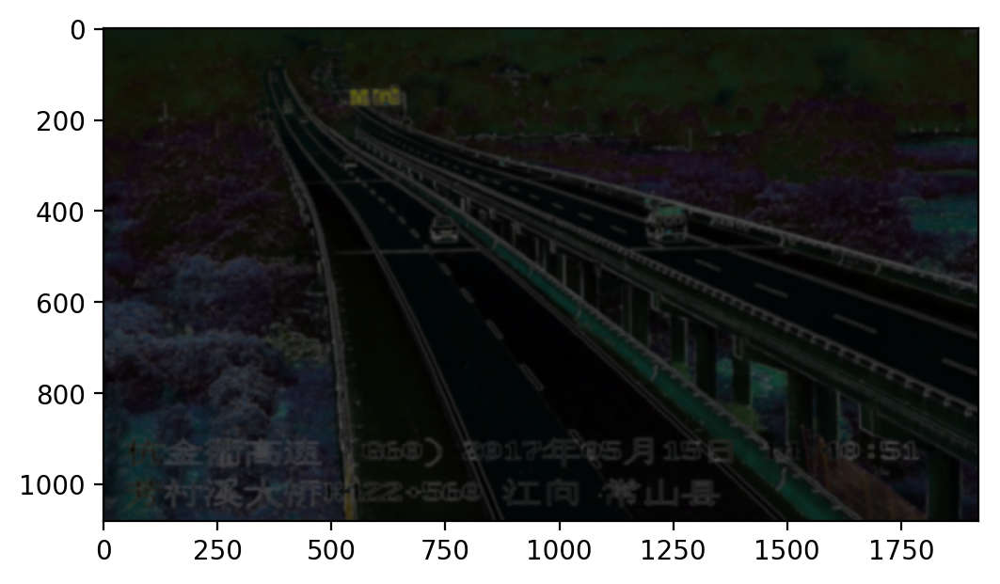

In [100]:
plt.imshow(sobel)
blurred = filters.gaussian(sobel, sigma=3.0)
plt.imshow(blurred)

In [104]:
import numpy as np
light_spots = np.array((img > 245).nonzero()).T

In [107]:
light_spots.shape

(177070, 3)

Text(0.5,1,'light spots in image')

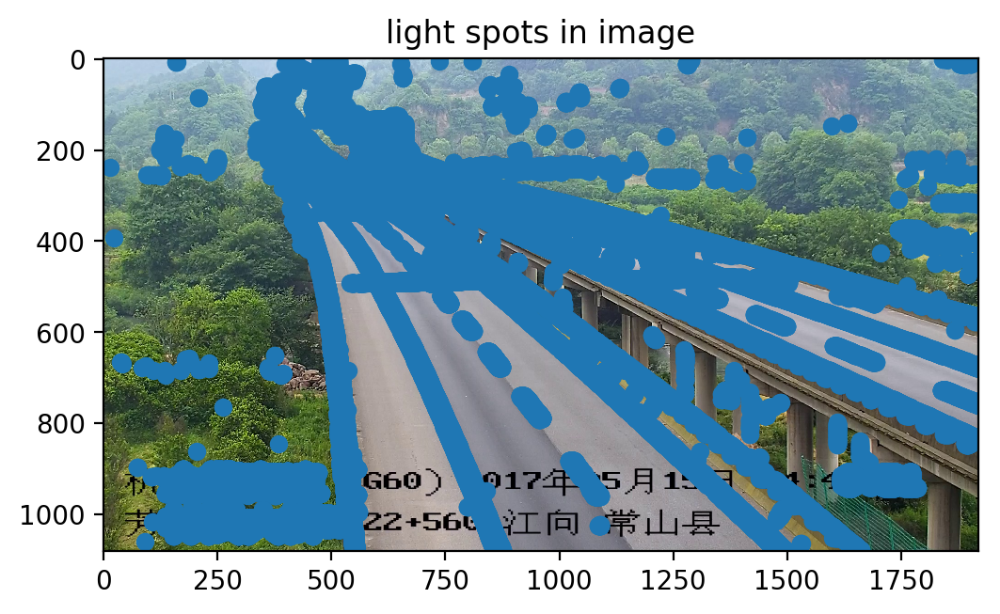

In [108]:
plt.plot(light_spots[:, 1], light_spots[:, 0], 'o')
plt.imshow(img)
plt.title('light spots in image')

In [115]:
dark_spots = np.array((img < 10).nonzero()).T

In [116]:
dark_spots.shape

(95152, 3)

Text(0.5,1,'dark spots in image')

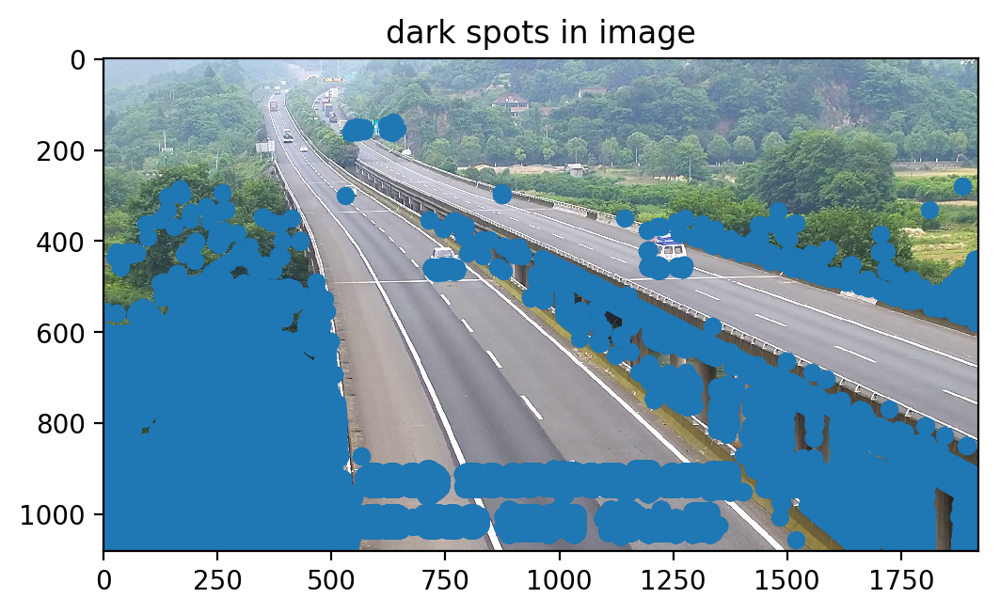

In [117]:
plt.plot(dark_spots[:, 1], dark_spots[:, 0], 'o')
plt.imshow(img)
plt.title('dark spots in image')

In [54]:
from scipy import ndimage as ndi
bool_mask = np.zeros(img.shape, dtype=np.bool)
bool_mask[tuple(light_spots.T)] = True
bool_mask[tuple(dark_spots.T)] = True
seed_mask, num_seeds = ndi.label(bool_mask)
num_seeds

8948

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\skimage\morphology\_deprecated.py:5: skimage_deprecation: Function ``watershed`` is deprecated and will be removed in version 0.19. Use ``skimage.segmentation.watershed`` instead.
  def watershed(image, markers=None, connectivity=1, offset=None, mask=None,
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


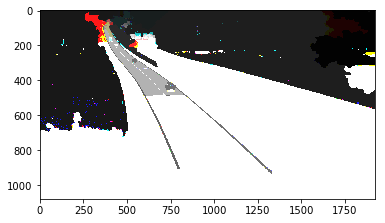

In [55]:
from skimage import morphology
ws = morphology.watershed(blurred, seed_mask)
plt.imshow(ws)

In [56]:
background = max(set(ws.ravel()), key=lambda g: np.sum(ws == g))
background

30

In [57]:
background_mask = (ws == background)

In [61]:
# plt.imshow(background_mask)

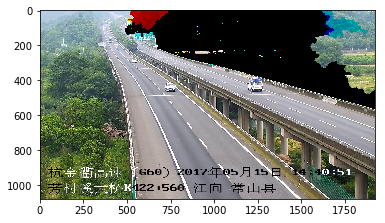

In [69]:
cleaned = img * ~background_mask
plt.imshow(cleaned)

In [67]:
seed_mask = np.zeros(img.shape, dtype=np.int)
seed_mask[0, 0] = 1 # background
seed_mask[600, 400] = 2 # foreground

In [279]:
##############################################
##############################################
##############################################

In [320]:

from IPython.display import Image #this is to render predictions

In [321]:
Image(filename='E:/code/Vehicle_Count/Traffic_Signs_Dataset/000000.jpg', width=500)

FileNotFoundError: [Errno 2] No such file or directory: 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/000000.jpg'

In [319]:
import numpy as np
from PIL import Image ,ImageEnhance
file = "E:/code/Vehicle_Count/Traffic_Signs_Dataset/000000.jpg"
img = Image.open(file)
converter = ImageEnhance.Color(img)
img2 = converter.enhance(8)

img2

FileNotFoundError: [Errno 2] No such file or directory: 'E:/code/Vehicle_Count/Traffic_Signs_Dataset/000000.jpg'

In [298]:
import numpy as np
from PIL import Image
# Image.fromarray(image_array).save('E:/code/Vehicle_Count/Traffic_Signs_Dataset/00000q.jpg')

# img = Image.open('loadimage.jpg')
img = img2.save('E:/code/Vehicle_Count/Traffic_Signs_Dataset/00000q.jpg')

In [ ]:
!python detect.py --source E:/code/Vehicle_Count/Traffic_Signs_Dataset/result.png --conf 0.25 --save-txt --save-conf --project E:/code/Vehicle_Count/Traffic_Signs_Dataset/results 

In [299]:
import cv2

img = cv2.imread("E:/code/Vehicle_Count/Traffic_Signs_Dataset/00000q.jpg")

hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
greenMask = cv2.inRange(hsv, (0, 51, 0), (102, 255, 102))

img[greenMask == 255] = (0, 250, 0)


# cv2.imshow('test', back)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [300]:
import numpy as np
from PIL import Image
Image.fromarray(img).save('E:/code/Vehicle_Count/Traffic_Signs_Dataset/00000e.jpg')


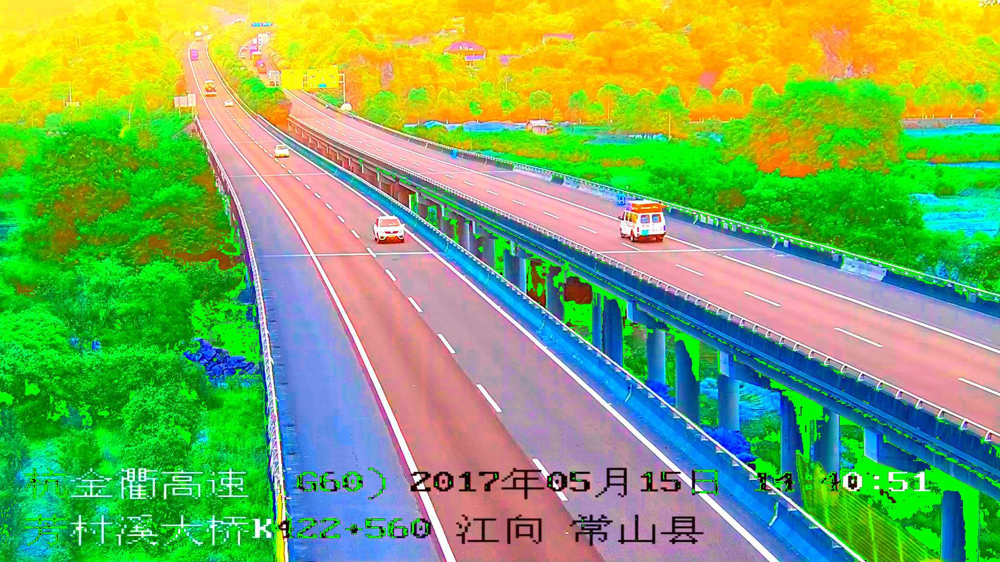

In [301]:
from IPython.display import Image #this is to render predictions
Image(filename='E:/code/Vehicle_Count/Traffic_Signs_Dataset/00000e.jpg', width=700)

In [304]:
import numpy as np
from PIL import Image
# Open image and make RGB and HSV versions
RGBim = Image.open("E:/code/Vehicle_Count/Traffic_Signs_Dataset/00000e.jpg").convert('RGB')
HSVim = RGBim.convert('HSV')

# Make numpy versions
RGBna = np.array(RGBim)
HSVna = np.array(HSVim)

# Extract Hue
H = HSVna[:,:,0]

# Find all green pixels, i.e. where 100 < Hue < 140
lo,hi = 90,200
# Rescale to 0-255, rather than 0-360 because we are using uint8
lo = int((lo * 255) / 360)
hi = int((hi * 255) / 360)
green = np.where((H>lo) & (H<hi))

# Make all green pixels black in original image
RGBna[green] = [0,0,0]

count = green[0].size
print("Pixels matched: {}".format(count))
Image.fromarray(RGBna).save('E:/code/Vehicle_Count/Traffic_Signs_Dataset/result.png')

Pixels matched: 738057


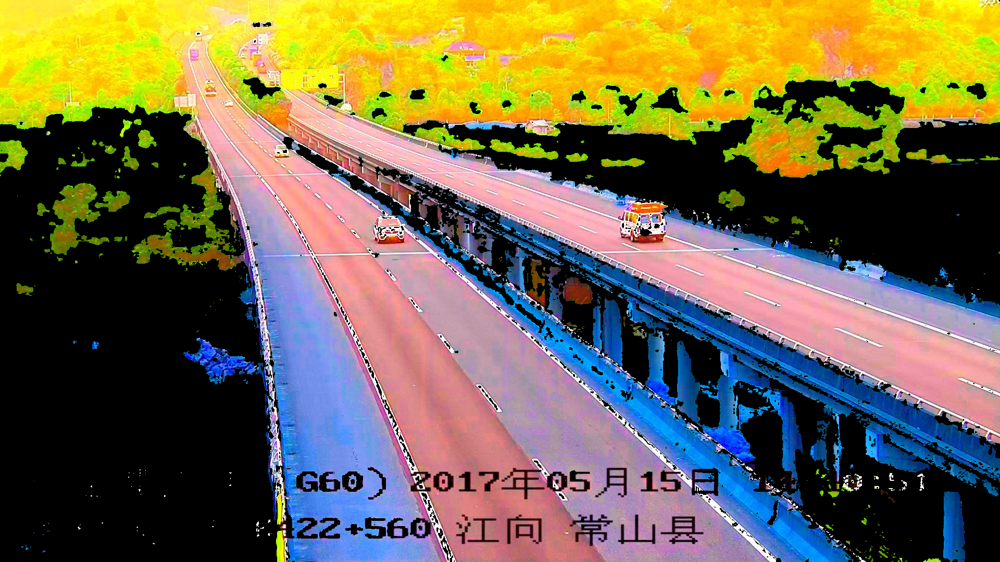

In [305]:
from IPython.display import Image #this is to render predictions
Image(filename='E:/code/Vehicle_Count/Traffic_Signs_Dataset/result.png', width=700)

In [314]:
!python detect.py --source E:/code/Vehicle_Count/Traffic_Signs_Dataset/result.png --conf 0.25 --save-txt --save-conf --project E:/code/Vehicle_Count/Traffic_Signs_Dataset/results 

detect: weights=yolov5s.pt, source=E:/code/Vehicle_Count/Traffic_Signs_Dataset/result.png, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=E:/code/Vehicle_Count/Traffic_Signs_Dataset/results, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5  v6.1-253-g75bbaa8 Python-3.10.4 torch-1.11.0+cpu CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
image 1/1 E:\code\Vehicle_Count\Traffic_Signs_Dataset\result.png: 384x640 1 car, 1 truck, Done. (0.162s)
Speed: 0.0ms pre-process, 161.6ms inference, 2.0ms NMS per image at shape (1, 3, 640, 640)
Results saved to E:\code\Vehicle_Count\Traffic_Signs_Dataset\results\exp
1 labels saved to E:\code\Vehicle_Count\Traffic_Signs_Dataset\results\exp\labels

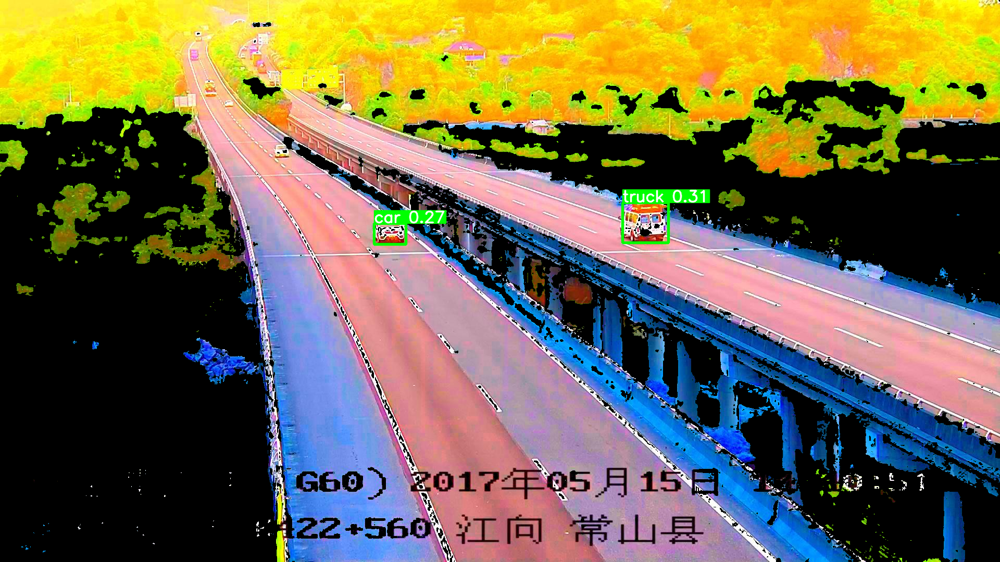

In [315]:
Image(filename='E:/code/Vehicle_Count/Traffic_Signs_Dataset/results/exp/result.png', width=700)

In [316]:
#Print vehicle count
try:
    file1 = open('E:/code/Vehicle_Count/Traffic_Signs_Dataset/results/exp/labels/result.txt', 'r')
    Lines = file1.readlines()

    total_count = 0
    car_count = 0
    bus_count = 0
    truck_count = 0
    
    # Strips the newline character
    for line in Lines:
        if(line.strip().split()[0]=="2"):
            car_count+=1
        elif(line.strip().split()[0]=="5"):
            bus_count+=1
        elif(line.strip().split()[0]=="7"):
            truck_count+=1
    total_count=car_count+bus_count+truck_count
    print("______________________\n")
    print("  Total Vehicles: {}".format(total_count))
    print("______________________")
    
except:
    print("______________________\n")
    print("  Total Vehicles: {}".format(0))
    print("______________________")




______________________

  Total Vehicles: 2
______________________


In [323]:
!pip install mediapipe

In [325]:
# DataFlair background removal 

# import necessary packages
import os
import cv2
import numpy as np
import mediapipe as mp


ModuleNotFoundError: No module named 'mediapipe'

In [ ]:

# initialize mediapipe 
mp_selfie_segmentation = mp.solutions.selfie_segmentation
selfie_segmentation = mp_selfie_segmentation.SelfieSegmentation(model_selection=1)

# store background images in a list
image_path = 'images'
images = os.listdir(image_path)

image_index= 0
bg_image = cv2.imread(image_path+'/'+images[image_index])

# create videocapture object to access the webcam
# cap = cv2.VideoCapture(0)

# while cap.isOpened():
#     _, frame = cap.read()

    # flip the frame to horizontal direction
# frame = cv2.flip(frame, 1)

frame = cv2.imread("E:/code/Vehicle_Count/Traffic_Signs_Dataset/images/000000.jpg")
height , width, channel = frame.shape

RGB = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

# get the result 
results = selfie_segmentation.process(RGB)

# extract segmented mask
mask = results.segmentation_mask

# it returns true or false where the condition applies in the mask
condition = np.stack((results.segmentation_mask,) * 3, axis=-1) > 0.6

# resize the background image to the same size of the original frame
bg_image = cv2.resize(bg_image, (width, height))

# combine frame and background image using the condition
output_image = np.where(condition, frame, bg_image)

# show outputs
#cv2.imshow("mask", mask)
cv2.imshow("Output", output_image)
cv2.imshow("Frame", frame)
    # key = cv2.waitKey(1)
    # if key == ord('q'):
    #     break

    # if 'd' key is pressed then change the background image
    # elif key == ord('d'):

    #     if image_index != len(images)-1:
    #         image_index += 1
    #     else:
    #         image_index = 0
    #     bg_image = cv2.imread(image_path+'/'+images[image_index])


# release the capture object and close all active windows 
# cap.release()
# cv2.destroyAllWindows()



